# Class 7: Discrete Derivatives as Convolutional Filters

Run the cell below to import the class modules.

If you get import warnings, try using **`Ctrl+M .`** to restart the kernel. *(notice there is a dot there)*

In [1]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

from scipy import signal

## Choosing, loading, and displaying an image

Like in Class 6, the options of source are: `insper`, `informatica`, `harvard`, `atletica`, `smash`, and `consulting`.



In [2]:
SOURCE = 'img/parede.jpg'

We will go back to the noise severities at the end of this handout.

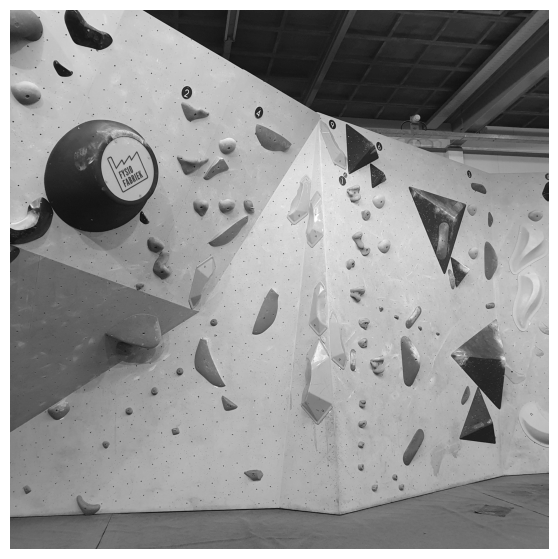

In [3]:
input = cv.imread(SOURCE, cv.IMREAD_GRAYSCALE)

plt.figure(figsize=(7, 7))
plt.imshow(input, cmap='gray')
plt.axis('off')
plt.show()

## Convenience functions

Thanks to the `signal` module of the SciPy library, we can have an easy and fast implementation of the 2D convolution we implemented in Class 6. However, we are going to use the `correlate2d` function instead of the `convolve2d` function because some of the kernels are not symmetric and we do not want to flip them.

The `mode='valid'` parameter ensures that the borders are ignored, like in Class 6. Read the [official documentation](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.correlate2d.html) for other possibilities.

In [8]:
def convolve(input, kernel):
    return signal.correlate2d(input, kernel, mode='valid')

For convenience, let's also define a normalization function, since the outputs of this notebook will often be outside the `[0, 255]` bounds.

In [9]:
def normalize(output):
    min = output.min()
    max = output.max()
    return 255 * (output - min) / (max - min)

## Sobel filters

### Sobel vertical edge filter

Convolution with a kernel that measures the gradient across the $x$ dimension.

In [10]:
Dx = np.array([
    [-1,  0,  1],
    [-2,  0,  2],
    [-1,  0,  1],
])

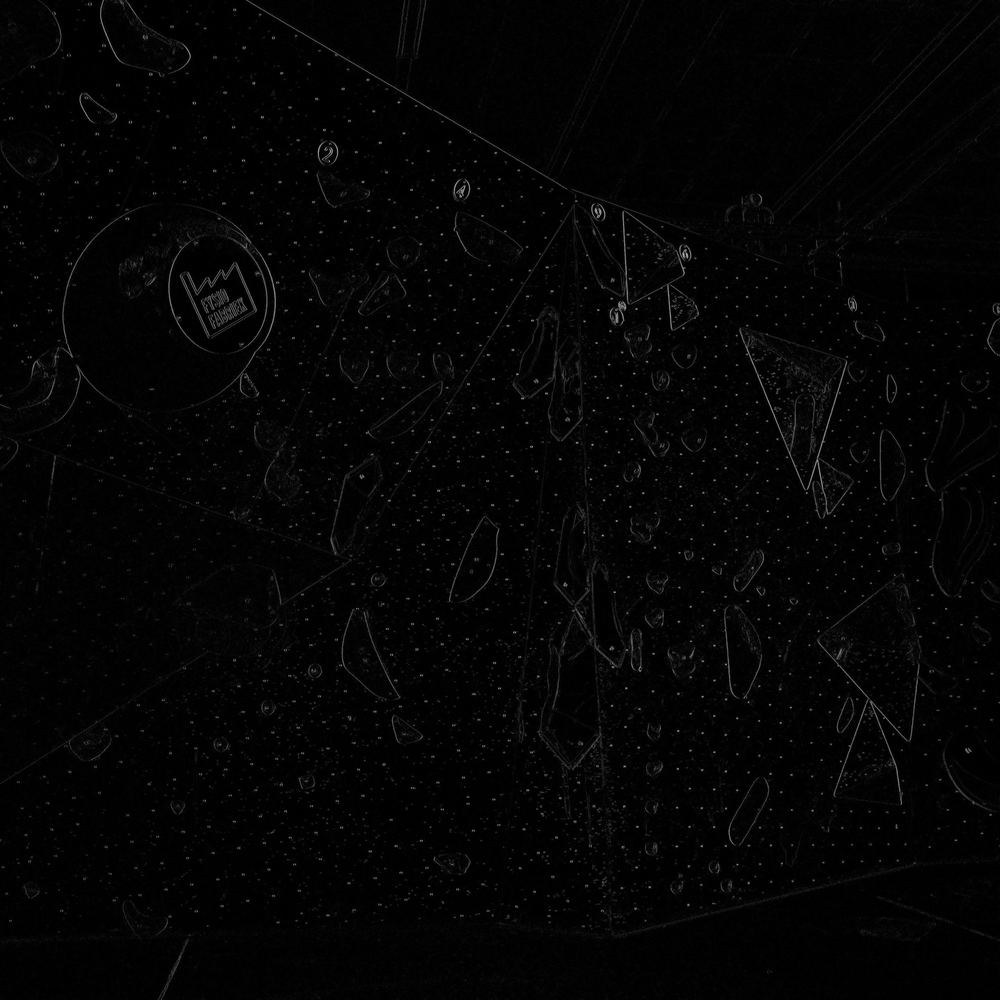

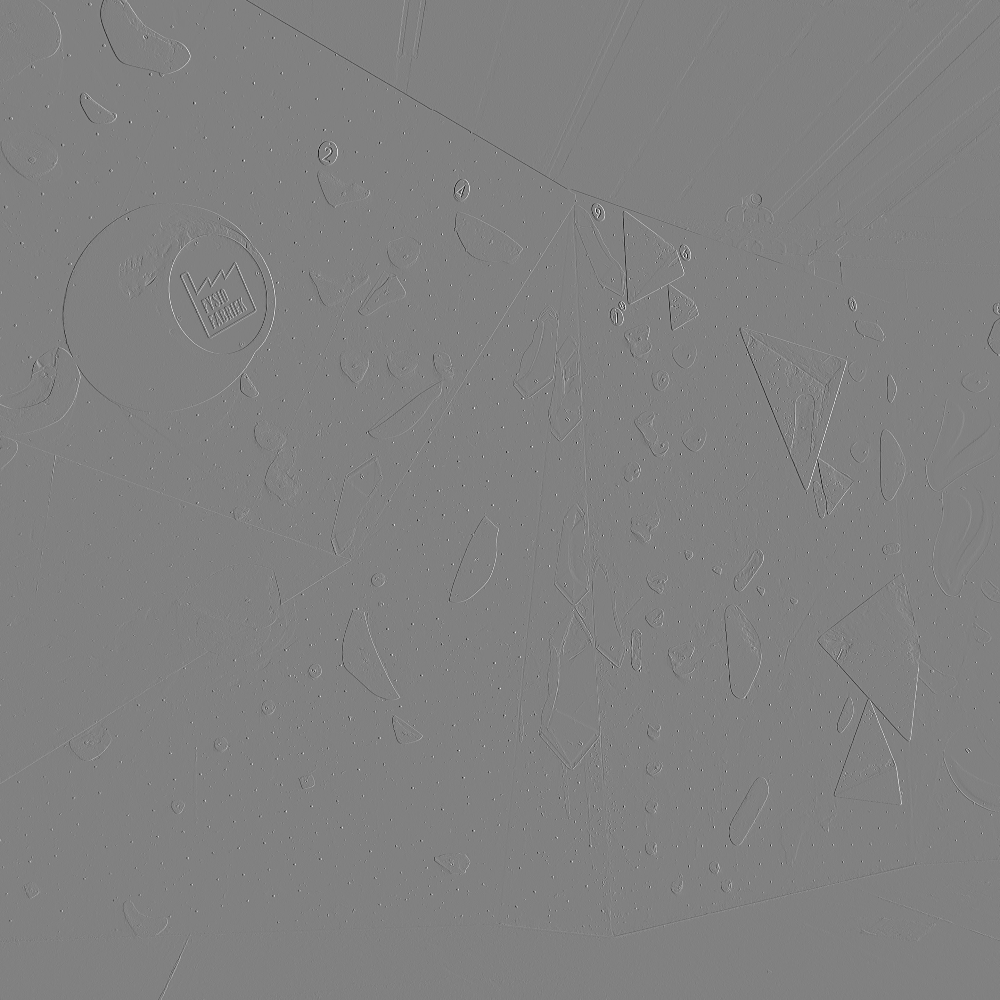

In [11]:
gradient_x = convolve(input, Dx)

cv_imshow(normalize(np.abs(gradient_x)))
cv_imshow(normalize(gradient_x))

### Sobel horizontal edge filter

Convolution with a kernel that measures the gradient across the $y$ dimension.

In [12]:
Dy = np.array([
    [-1, -2, -1],
    [ 0,  0,  0],
    [ 1,  2,  1],
])

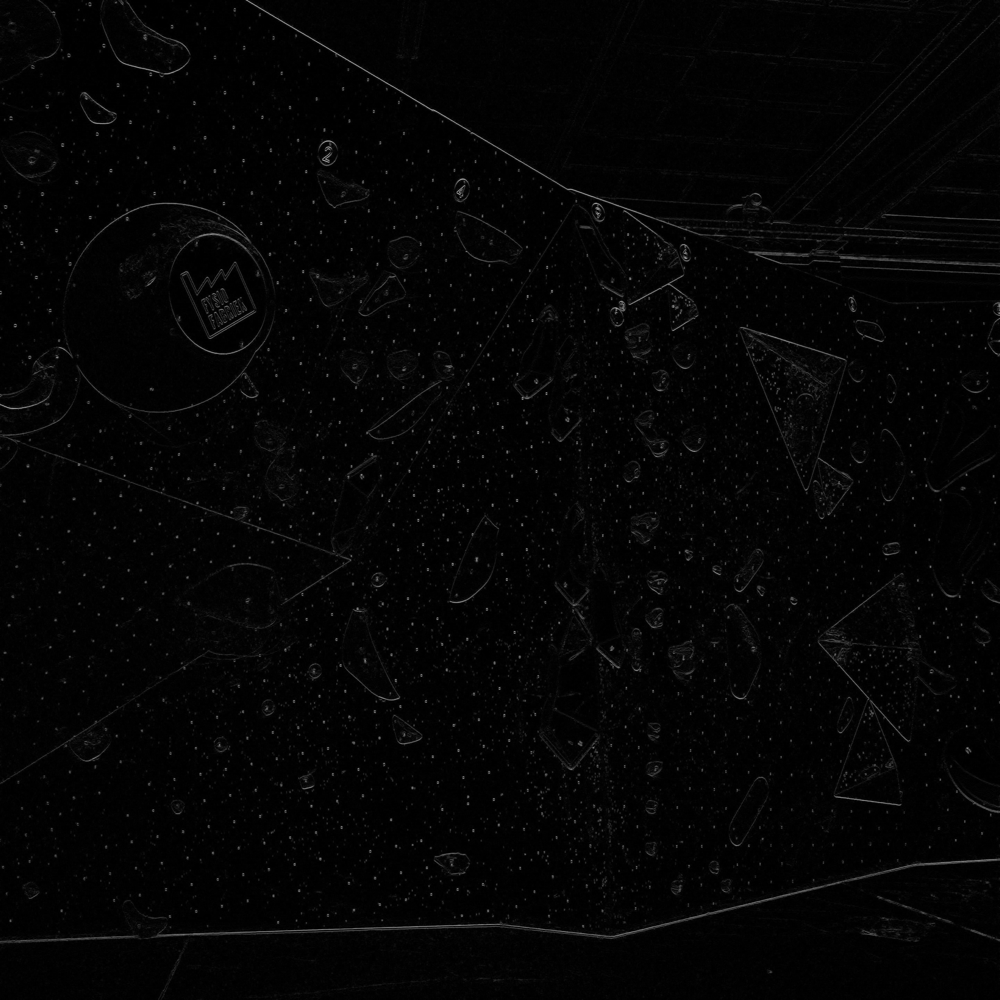

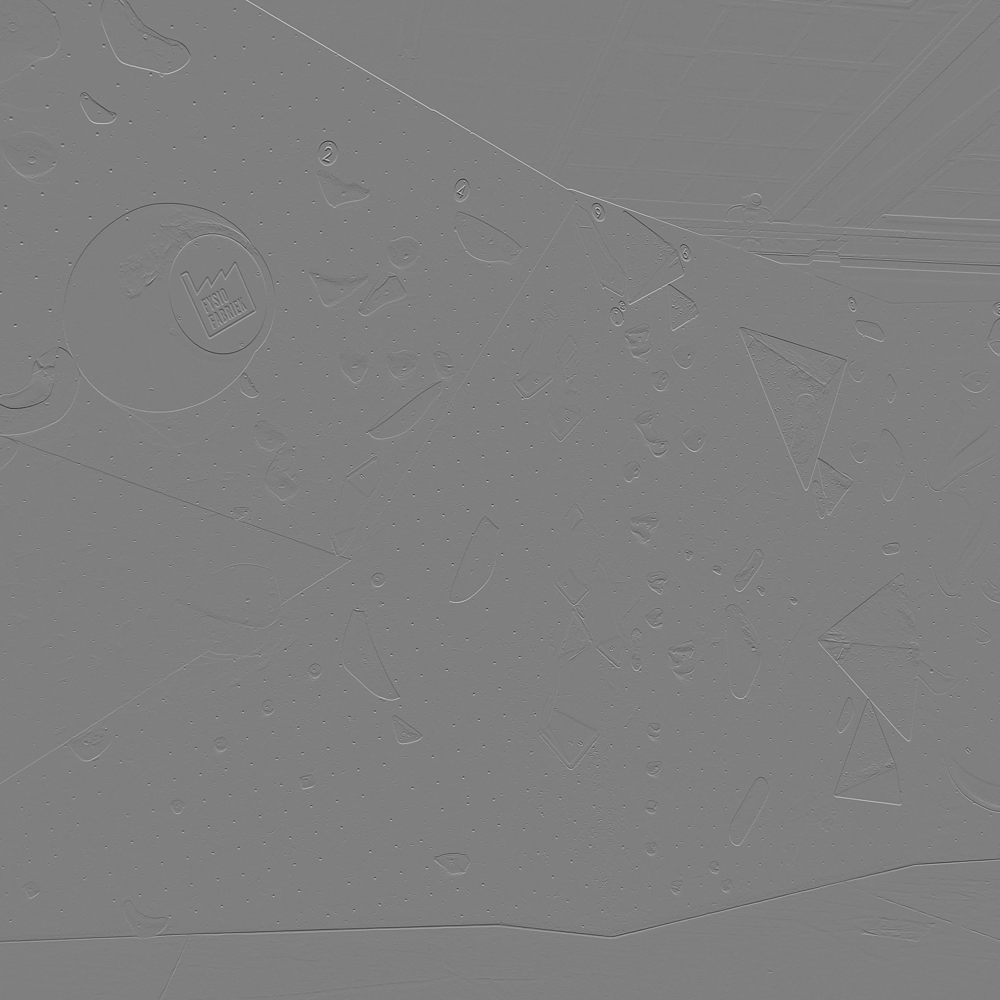

In [13]:
gradient_y = convolve(input, Dy)

cv_imshow(normalize(np.abs(gradient_y)))
cv_imshow(normalize(gradient_y))

### Gradient intensity

The absolute value of the `gx + gy` vector.

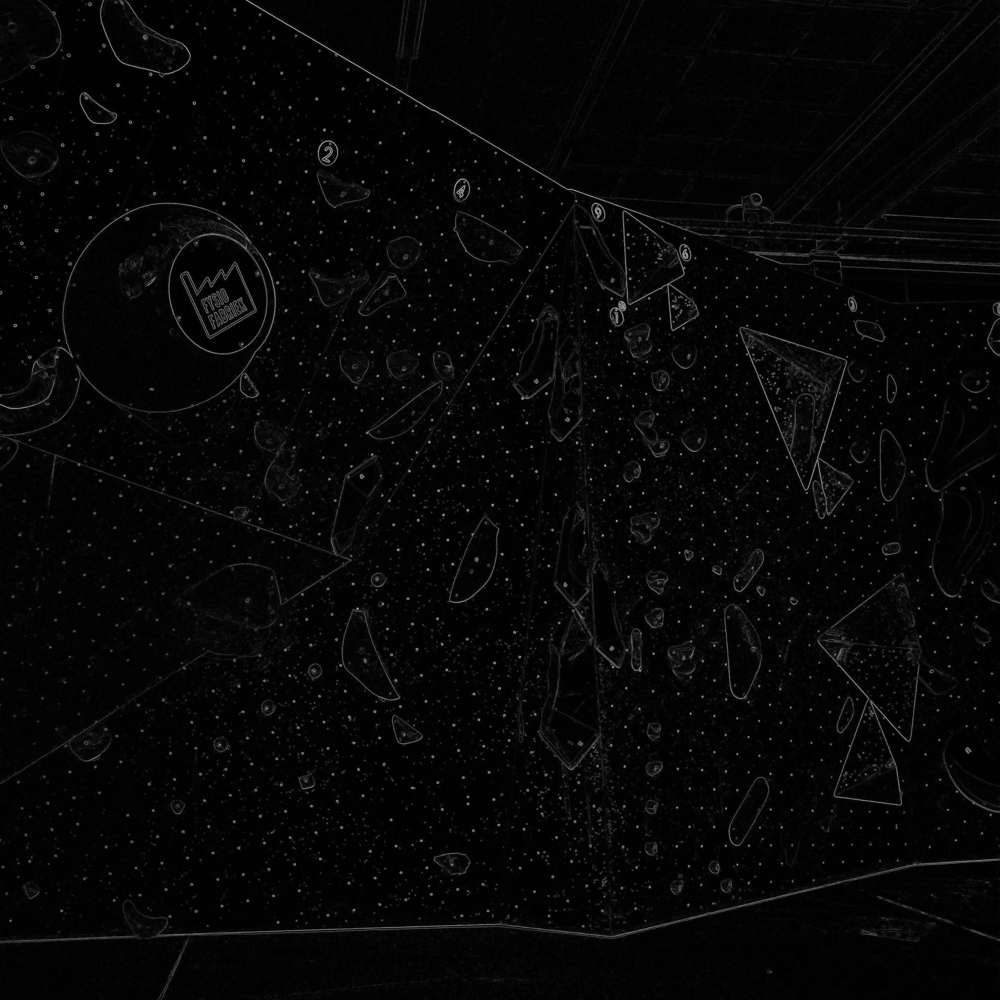

In [14]:
gradient = np.sqrt(gradient_x ** 2 + gradient_y ** 2)

cv_imshow(normalize(gradient))

You can examine this result for other sources.

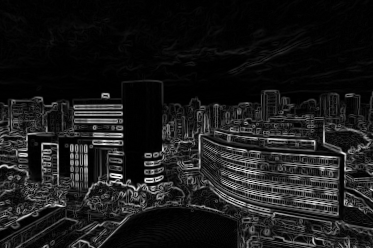

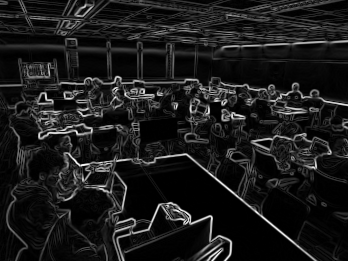

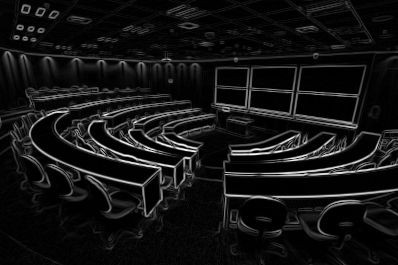

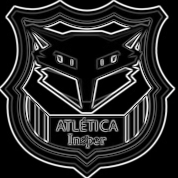

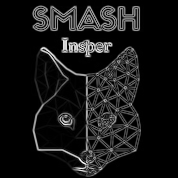

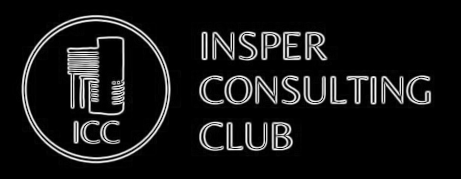

In [15]:
for source in ['insper', 'informatica', 'harvard', 'atletica', 'smash', 'consulting']:
    image = cv_grayread(f'{source}.png', asfloat=True)
    gradient_x = convolve(image, Dx)
    gradient_y = convolve(image, Dy)
    gradient = np.sqrt(gradient_x ** 2 + gradient_y ** 2)
    cv_imshow(normalize(gradient))

## Laplacian filter

Convolution with a kernel that is the sum of the second partial derivatives.

In [16]:
L = np.array([
    [ 0,  1,  0],
    [ 1, -4,  1],
    [ 0,  1,  0],
])

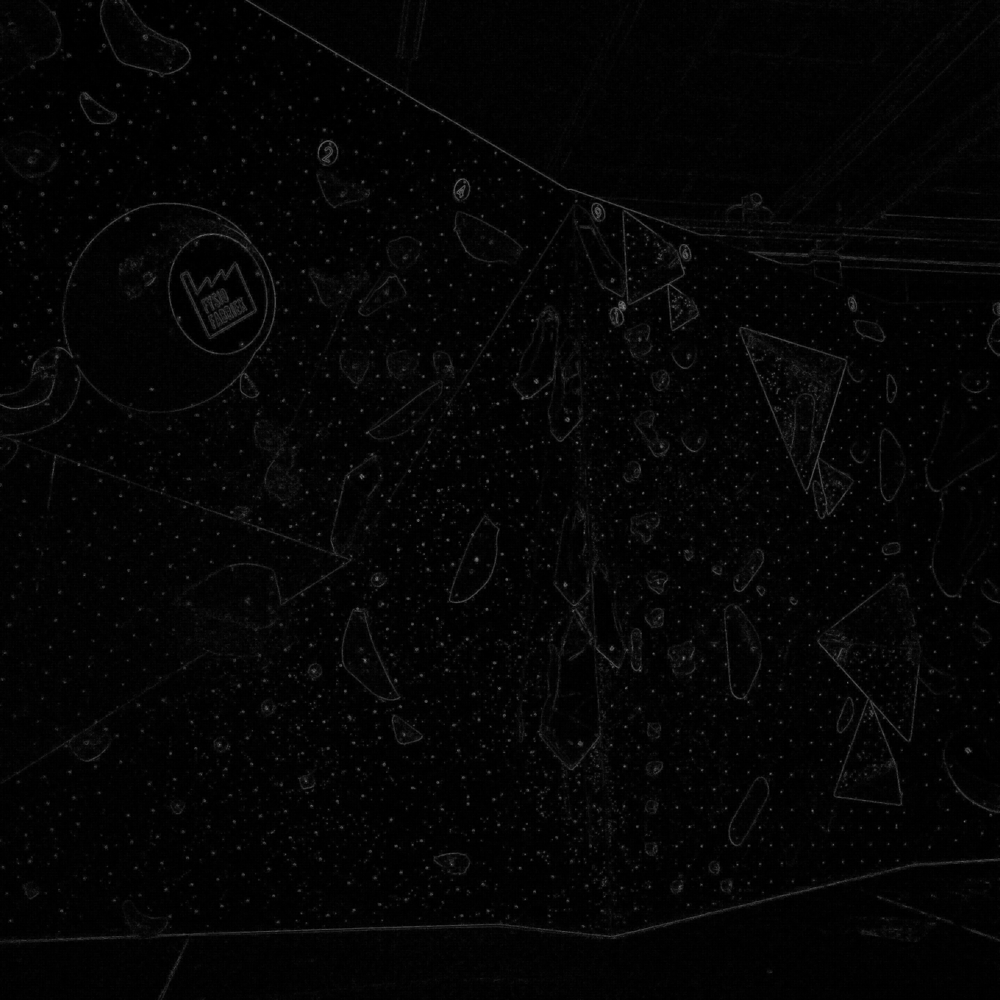

In [17]:
edges = convolve(input, L)

cv_imshow(normalize(np.abs(edges)))

You can examine this result for other sources.

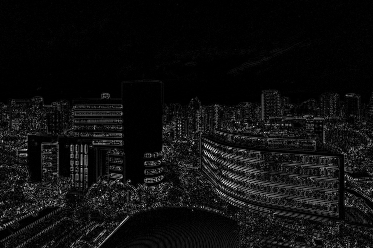

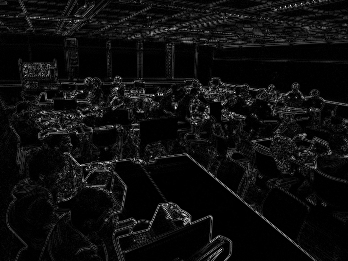

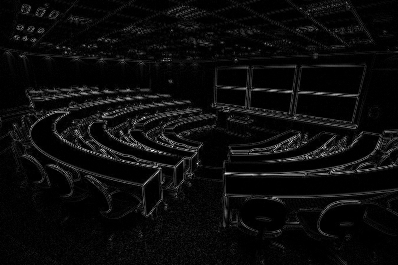

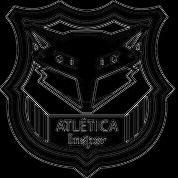

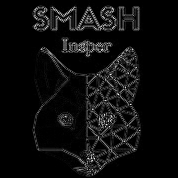

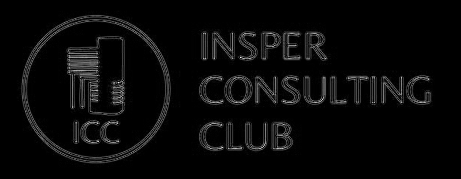

In [18]:
for source in ['insper', 'informatica', 'harvard', 'atletica', 'smash', 'consulting']:
    image = cv_grayread(f'{source}.png', asfloat=True)
    edges = convolve(image, L)
    cv_imshow(normalize(np.abs(edges)))

## Bringing back the issue of noise

When we bring back the issue of noise, an obvious problem is noticed: noises are somewhat sudden variations. Therefore, they give strong responses to an edge detector.

Like in Class 6, the options of severity are `8`, `16`, and `32`.

In [19]:
SEVERITY = 8

In [20]:
noisy_input = cv_grayread(f'{SOURCE}-{SEVERITY}.png', asfloat=True)

cv_imshow(noisy_input)

ValueError: File "/parede.jpg-8.png" does not exist

In [21]:
noisy_edges = convolve(noisy_input, L)

cv_imshow(normalize(np.abs(noisy_edges)))

NameError: name 'noisy_input' is not defined

This can be mitigated, however, by smoothing the image before detecting the edges. And thanks again to the `signal` module of the SciPy library, we can have an easy and fast implementation of the Gaussian kernel we implemented in Class 6.

In [ ]:
def gaussian_kernel(n, sigma, normal=True):
    g1d = signal.windows.gaussian(n, sigma)

    pi_div = 2 * np.pi * sigma ** 2

    g2d = np.outer(g1d, g1d) / pi_div

    if normal:
        g2d /= g2d.sum()

    return g2d

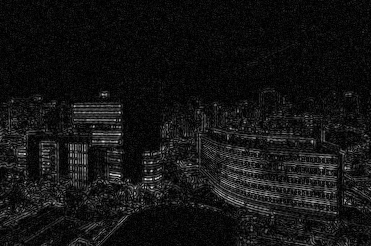

In [ ]:
smooth_input = convolve(noisy_input, gaussian_kernel(3, 1))

smooth_edges = convolve(smooth_input, L)

cv_imshow(normalize(np.abs(smooth_edges)))

## Challenge

Try to obtain the result above with a **single convolution**.

In other words, try to build a "super kernel" that implements both operations at once.

In [ ]:
G = gaussian_kernel(3, 1)

K = signal.correlate2d(G, L, mode='full')

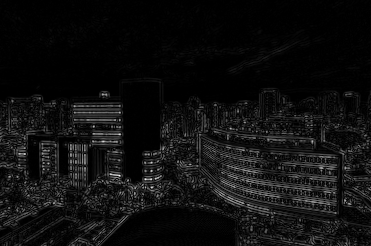

In [ ]:
output = convolve(input, K)

cv_imshow(normalize(np.abs(output)))

Once your code is working, you can examine its result for the same source but other severities...

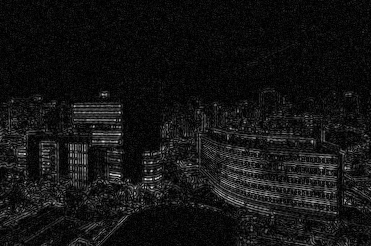

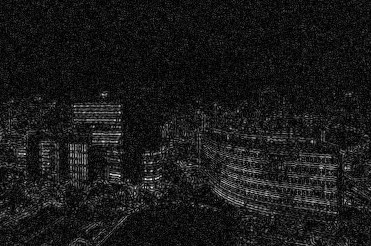

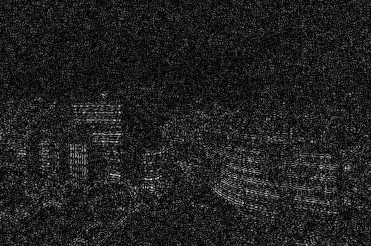

In [ ]:
for severity in [8, 16, 32]:
    image = cv_grayread(f'{SOURCE}-{severity}.png', asfloat=True)
    output = convolve(image, K)
    cv_imshow(normalize(np.abs(output)))

...or for the same severity but other sources.

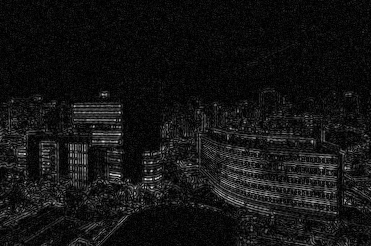

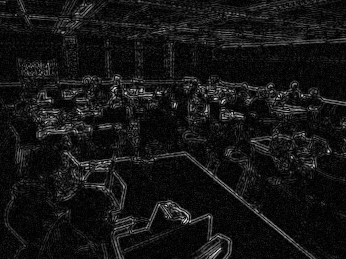

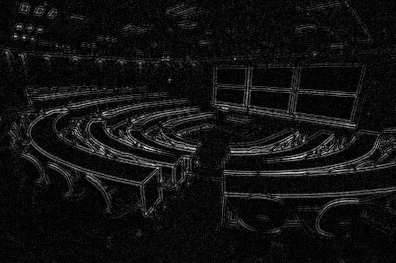

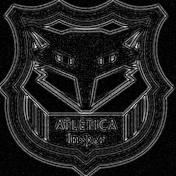

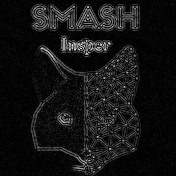

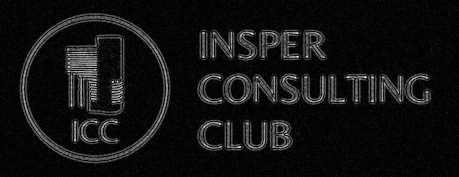

In [ ]:
for source in ['insper', 'informatica', 'harvard', 'atletica', 'smash', 'consulting']:
    image = cv_grayread(f'{source}-{SEVERITY}.png', asfloat=True)
    output = convolve(image, K)
    cv_imshow(normalize(np.abs(output)))

## OpenCV references

* [cv.Sobel](https://docs.opencv.org/4.x/d4/d86/group__imgproc__filter.html#gacea54f142e81b6758cb6f375ce782c8d)

* [cv.Laplacian](https://docs.opencv.org/4.x/d4/d86/group__imgproc__filter.html#gad78703e4c8fe703d479c1860d76429e6)

You can click on the toc.png tab to the left to browse by section.